<a href="https://colab.research.google.com/github/Niamh2602/test/blob/main/Project_test_(Accommodation%20only%20with%20folium%20map).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [177]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from google.colab import files
import io
import pandas as pd
import folium 
import gc


data = files.upload()

Saving Accommodation_Tags.csv to Accommodation_Tags (7).csv


In [178]:
Accommodation = pd.read_csv('Accommodation_Tags.csv', header = 0, index_col= None)


In [179]:
Accommodation.head()

,Name,Url,Telephone,Longitude,Latitude,AddressRegion,AddressLocality,AddressCountry,Original Tags,Covid Safety Charter,Tags
0,Bramble Rock,http://www.bramblerock.com,+353(0)40445075,-6.291733,53.009756,Wicklow,Glendalough,Republic of Ireland,B&B,Not applicable,B&B
1,The Davenport,http://www.instagram.com/thedavenportdublin/,+353(0)16073500,-6.250031,53.341665,Dublin,Dublin City,Republic of Ireland,"Hotel,Covid Safety Charter",Covid Safety Charter,Hotel
2,Townsend House,http://www.townsendhouse-guesthouse.com,+353(0)579121276,-7.909500,53.098816,Offaly,Birr,Republic of Ireland,"Guesthouse,Covid Safety Charter",Covid Safety Charter,Guesthouse
3,River's Edge,http://www.riversedge.ie,3.54E+11,-9.783882,52.106485,Kerry,Killorglin,Ireland,"B&B,B&B Ireland",Not applicable,B&B
4,Amber Springs Hotel & Health Spa,https://www.ambersprings.ie/,+353(0)539484000,-6.290339,52.668124,Wexford,Gorey,Republic of Ireland,"Hotel,Covid Safety Charter,Stay and Spend",Covid Safety Charter,Hotel


In [180]:
Accommodation.isnull().sum()

Name                      0
Url                     182
Telephone                 5
Longitude                 0
Latitude                  0
AddressRegion             0
AddressLocality         142
AddressCountry            0
Original Tags             0
Covid Safety Charter      0
Tags                      0
dtype: int64

In [181]:
Accommodation.drop(['Url', 'Telephone','AddressLocality', 'AddressCountry' , 'Original Tags'], axis=1)
Ireland = Accommodation.drop(['Url','Telephone','AddressLocality', 'AddressCountry', 'Original Tags'], axis=1)
print(Ireland)

                                  Name  Longitude   Latitude AddressRegion  \
0                         Bramble Rock  -6.291733  53.009756       Wicklow   
1                        The Davenport  -6.250031  53.341665        Dublin   
2                       Townsend House  -7.909500  53.098816        Offaly   
3                         River's Edge  -9.783882  52.106485         Kerry   
4     Amber Springs Hotel & Health Spa  -6.290339  52.668124       Wexford   
...                                ...        ...        ...           ...   
2768                   The Savoy Hotel  -8.629061  52.663152      Limerick   
2769                  Dunmanus Cottage  -9.542522  51.602650          Cork   
2770           Travelodge Cork Airport  -8.470095  51.872450          Cork   
2771             Victoria Towers Hotel  -9.047777  53.273056        Galway   
2772                 The Botanical B&B  -9.568428  51.777403          Cork   

      Covid Safety Charter                         Tags  
0    

In [182]:
Ireland.columns = Ireland.columns.str.replace("AddressRegion" , "County")
Ireland.head()

,Name,Longitude,Latitude,County,Covid Safety Charter,Tags
0,Bramble Rock,-6.291733,53.009756,Wicklow,Not applicable,B&B
1,The Davenport,-6.250031,53.341665,Dublin,Covid Safety Charter,Hotel
2,Townsend House,-7.909500,53.098816,Offaly,Covid Safety Charter,Guesthouse
3,River's Edge,-9.783882,52.106485,Kerry,Not applicable,B&B
4,Amber Springs Hotel & Health Spa,-6.290339,52.668124,Wexford,Covid Safety Charter,Hotel


In [183]:
# Visualize the categories
print(Ireland.Tags.value_counts().iloc[:])
print("Total Tags :",Ireland.Tags.value_counts().shape)


B&B                            1070
Hotel                           819
Self Catering Accommodation     515
Guesthouse                      138
Camping                         109
Hostel                           97
Camping & Glamping               25
Name: Tags, dtype: int64
Total Tags : (7,)


/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


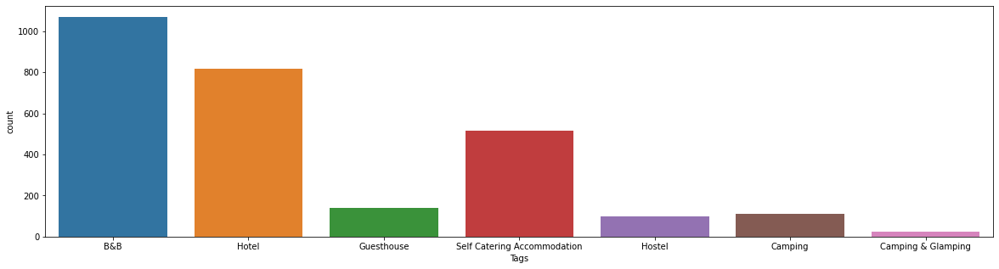

In [184]:
fig = plt.figure(figsize = (20,5))
sns.countplot(Ireland["Tags"][:])

In [188]:
#Ireland is located at latitude 53.41291 and longitude -8.24389
#map = f1.Map([53.009756, -6.291733],zoom_start = 15)
map = folium.Map(location=[53.009756, -6.291733], tiles = "OpenStreetMap", zoom_start = 7)
map

In [175]:
#from folium.folium import Map
# grouping dataframe by category
#Ireland = Ireland.groupby("Tags")
#map

In [208]:
#folium.Marker(location=[53.009756, -6.291733], tiles = "OpenStreetMap", popups = "Text", icon = folium.Icon(color='blue')).add_to(map)
for i,row in Ireland.iterrows():
  lat = Ireland.at[i, 'Latitude']
  lon = Ireland.at[i, 'Longitude']
  name = Ireland.at[i, 'Name']
  tag = Ireland.at[i, 'Tags']

  if tag == 'Hotel':
    color = 'Blue'
    if tag == 'B&B':
     color = 'Red'
    if tag == 'Hostel':
      color = 'Yellow'
    if tag == 'Self Catering Accommodation':
      color = 'Green'
    if tag == 'Guesthouse':
      color = 'Brown'
    if tag == 'Camping & Glamping':
      color = 'Orange'
  else:
    color = 'Red'
  
  folium.Marker(location=[lat,lon], popup=tag, icon = folium.Icon(color=color)).add_to(map)
map




In [176]:
# extracting  all the rows with hotels
hotels = Ireland.get_group('Hotel')
print(hotels.head(5))

# Separating the hotel locations and converting each attribute into list
lat = list(hotels["Latitude"])
lon = list(hotels["Longitude"])
name = list(hotels["Name"])
cat = list(hotels["Tags"])

# visualize / locate hotels--->Markers in red
for lt,ln,name,cat in zip(lat,lon,name,cat):
    fl.Marker(location = [lt,ln], tooltip = str(name) +","+str(cat), icon = fl.Icon(color = 'blue')).add_to(map)
map

                                Name  Longitude   Latitude     County  \
1                      The Davenport  -6.250031  53.341665     Dublin   
4   Amber Springs Hotel & Health Spa  -6.290339  52.668124    Wexford   
7                     Salthill Hotel  -9.087343  53.258657     Galway   
9     Tower Hotel and Leisure Centre  -7.104975  52.260068  Waterford   
12                     Hotel Kilmore  -7.322925  53.987031      Cavan   

    Covid Safety Charter   Tags  
1   Covid Safety Charter  Hotel  
4   Covid Safety Charter  Hotel  
7   Covid Safety Charter  Hotel  
9   Covid Safety Charter  Hotel  
12  Covid Safety Charter  Hotel  


NameError: ignored